In [1]:
import comet_ml
from comet_ml import Experiment

import pandas as pd
import numpy as np
import networkx as nx

import gc

from tqdm.notebook import tqdm, tnrange

import seaborn as sns
from matplotlib import pyplot as plt
from matplotlib import animation, rcParams
from IPython.display import clear_output, HTML

from data.utils import *

import itertools

import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset

rcParams['animation.embed_limit'] = 2**128

COMET_ML_API_KEY      = ''
COMET_ML_PROJECT_NAME = 'traffic-modeling'
COMET_ML_WORKSPACE    = 'nikolai-semenov'

In [2]:
adjacency_matrix, speed_data, locations, distances = load(
    'data/third_party/DCRNN/data/sensor_graph/adj_mx_bay.pkl',
    'data/third_party/PeMS-BAY/pems-bay.h5',
    'data/third_party/DCRNN/data/sensor_graph/graph_sensor_locations_bay.csv',
    'data/third_party/DCRNN/data/sensor_graph/distances_bay_2017.csv'
)

# EDA

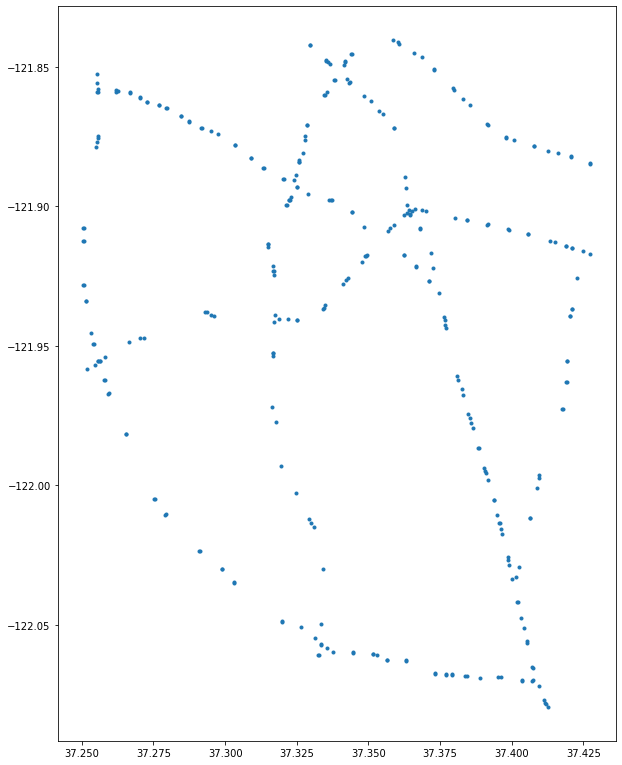

In [3]:
aspect_ratio = (locations['y'].max() - locations['y'].min()) / (locations['x'].max() - locations['x'].min())
plt.figure(figsize=(10, aspect_ratio * 10))
plt.scatter(locations['x'], locations['y'], marker='.')

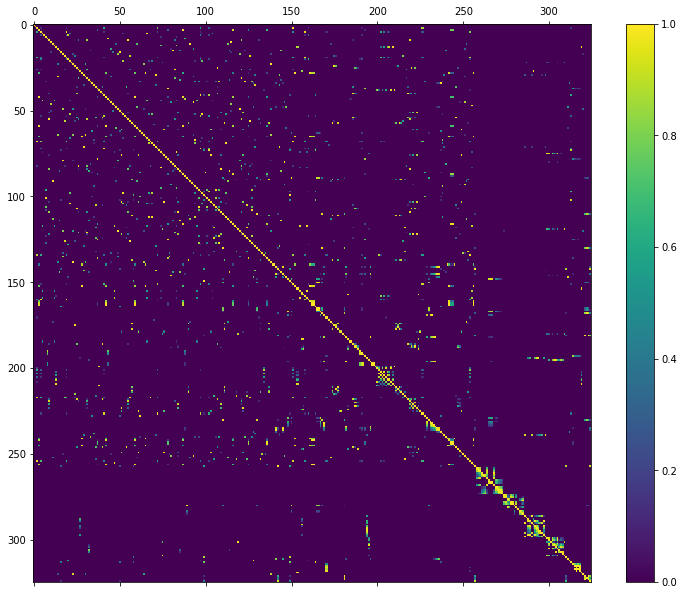

In [4]:
plt.figure(figsize=(12.5, 10))
plt.matshow(adjacency_matrix, fignum=1)
plt.colorbar()

In [5]:
network = nx.from_numpy_matrix(adjacency_matrix)

In [6]:
speed_data

,0,1,2,3,4,5,6,7,8,9,...,315,316,317,318,319,320,321,322,323,324
2017-01-01 00:00:00,71.4,67.8,70.5,67.4,68.8,66.6,66.8,68.0,66.8,69.0,...,68.8,67.9,68.8,68.0,69.2,68.9,70.4,68.8,71.1,68.0
2017-01-01 00:05:00,71.6,67.5,70.6,67.5,68.7,66.6,66.8,67.8,66.5,68.2,...,68.4,67.3,68.4,67.6,70.4,68.8,70.1,68.4,70.8,67.4
2017-01-01 00:10:00,71.6,67.6,70.2,67.4,68.7,66.1,66.8,67.8,66.2,67.8,...,68.4,67.4,68.4,67.5,70.2,68.3,69.8,68.4,70.5,67.9
2017-01-01 00:15:00,71.1,67.5,70.3,68.0,68.5,66.7,66.6,67.7,65.9,67.8,...,68.5,67.5,68.5,67.5,70.4,68.7,70.2,68.4,70.8,67.6
2017-01-01 00:20:00,71.7,67.8,70.2,68.1,68.4,66.9,66.1,67.7,66.1,67.8,...,68.5,67.7,68.5,67.4,69.6,69.1,70.0,68.4,71.0,67.9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2017-06-30 23:35:00,70.9,66.3,68.4,61.0,61.8,66.9,66.0,67.4,65.4,69.3,...,64.6,66.8,64.7,61.1,68.4,61.4,70.5,68.2,71.6,66.2
2017-06-30 23:40:00,71.3,66.6,68.7,60.9,62.0,66.2,66.5,68.2,64.9,69.1,...,65.1,67.3,64.8,60.8,69.8,62.2,69.4,68.6,71.6,68.4
2017-06-30 23:45:00,71.4,66.9,68.1,61.1,62.0,66.7,65.8,68.2,64.2,69.1,...,64.9,66.5,64.6,61.3,69.5,63.8,70.6,68.4,71.6,66.6
2017-06-30 23:50:00,72.2,66.5,68.0,61.1,62.5,65.8,67.1,68.3,64.0,67.3,...,64.1,65.9,64.8,61.3,69.6,64.2,70.2,68.7,71.6,68.4


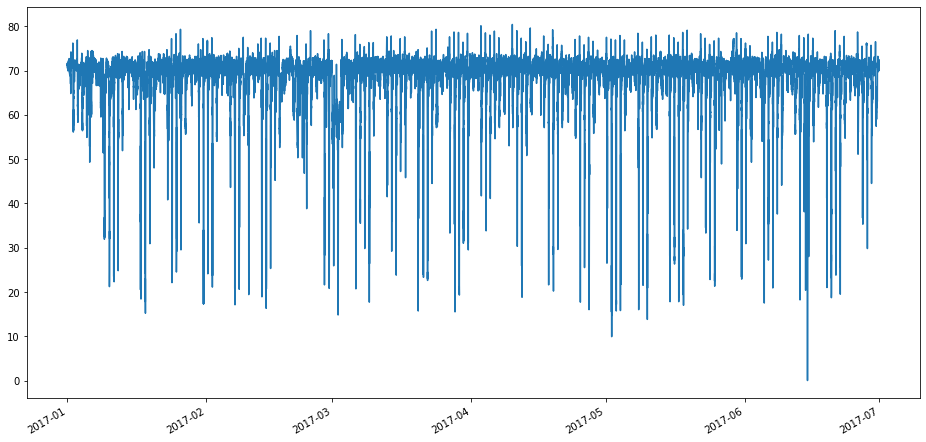

In [7]:
plt.figure(figsize=(16, 8))
speed_data[0].plot();

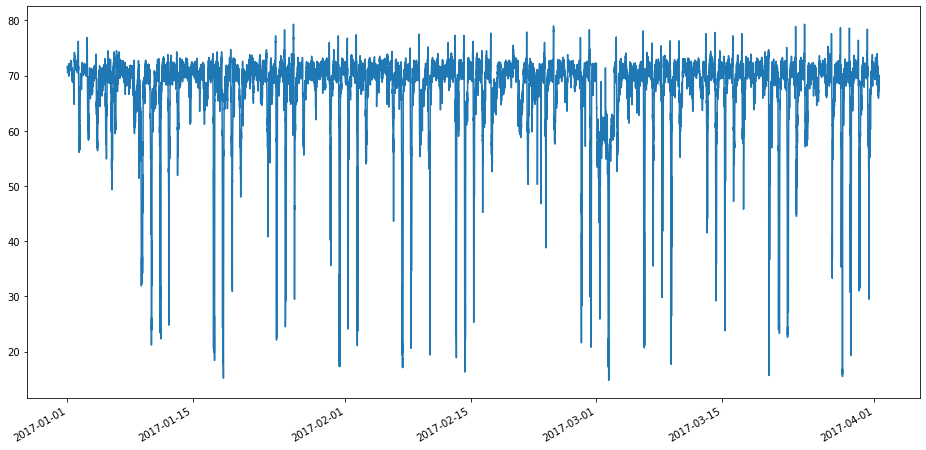

In [8]:
plt.figure(figsize=(16, 8))
speed_data[0].iloc[:speed_data.shape[0] // 2].plot();

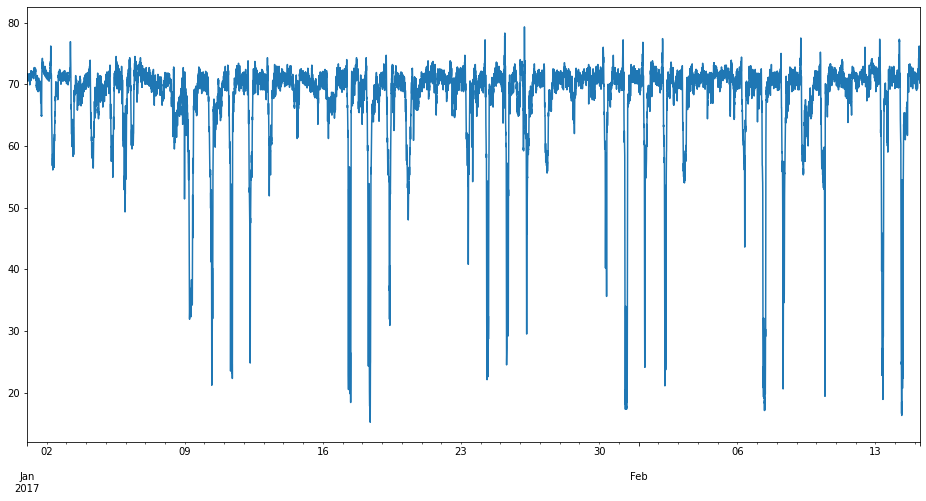

In [9]:
plt.figure(figsize=(16, 8))
speed_data[0].iloc[:speed_data.shape[0] // 4].plot();

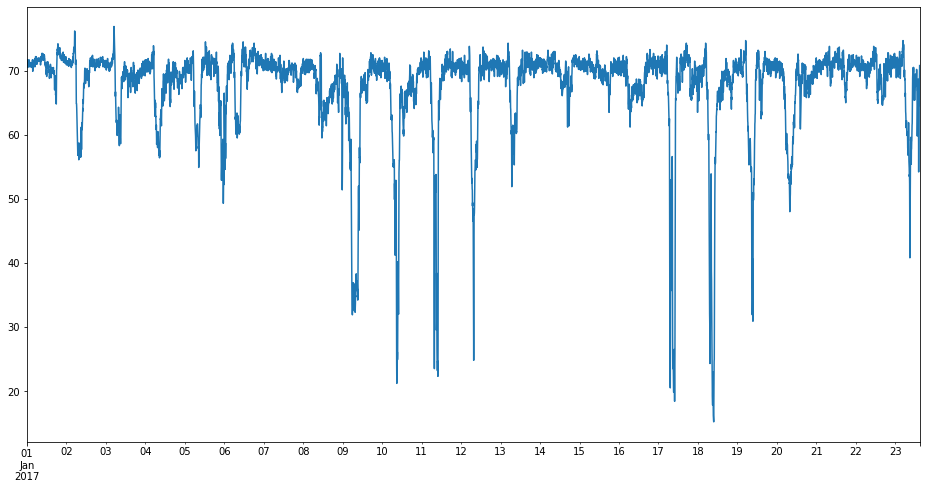

In [10]:
plt.figure(figsize=(16, 8))
speed_data[0].iloc[:speed_data.shape[0] // 8].plot();

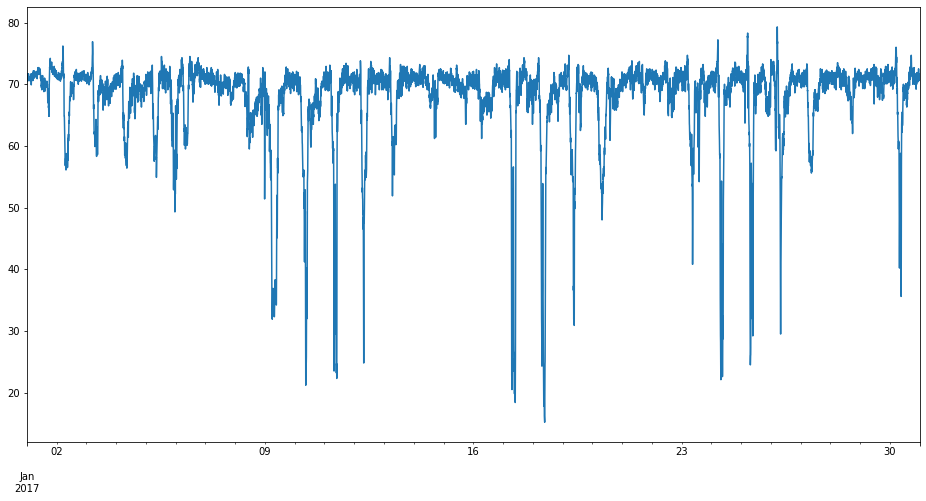

In [11]:
plt.figure(figsize=(16, 8))
speed_data[0].iloc[:30*24*12].plot();

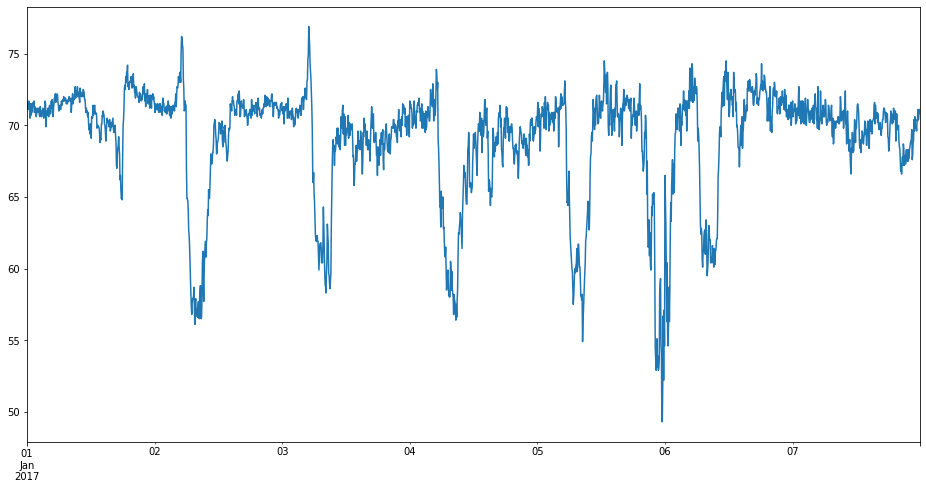

In [12]:
plt.figure(figsize=(16, 8))
speed_data[0].iloc[:7*24*12].plot();

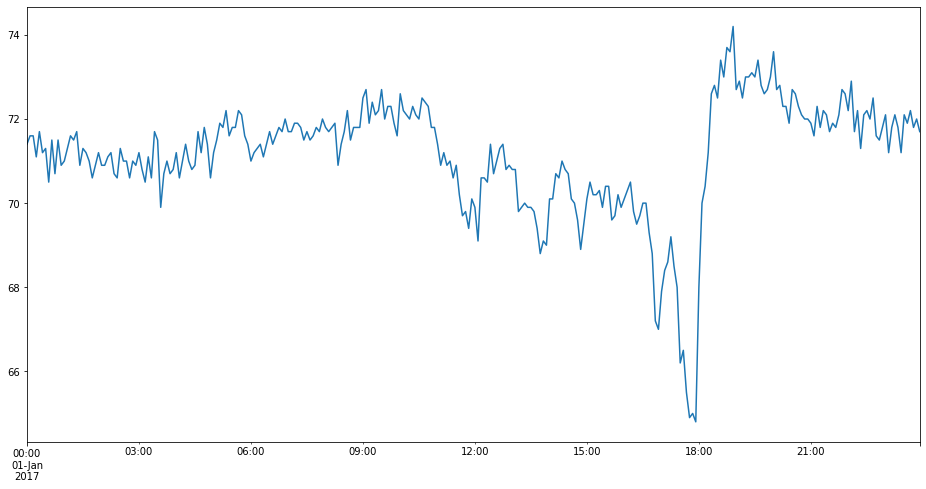

In [13]:
plt.figure(figsize=(16, 8))
speed_data[0].iloc[:24*12].plot();

In [39]:
def plot(velocity_timestamp, line):
    velocity, timestamp = velocity_timestamp
    ax.clear()
    ax.set_ylim(0, 1.1)
    ax.text(
        x=0,
        y=1,
        s=str(timestamp),
        horizontalalignment='left',
        verticalalignment='center'
    )
    ax.plot(velocity)

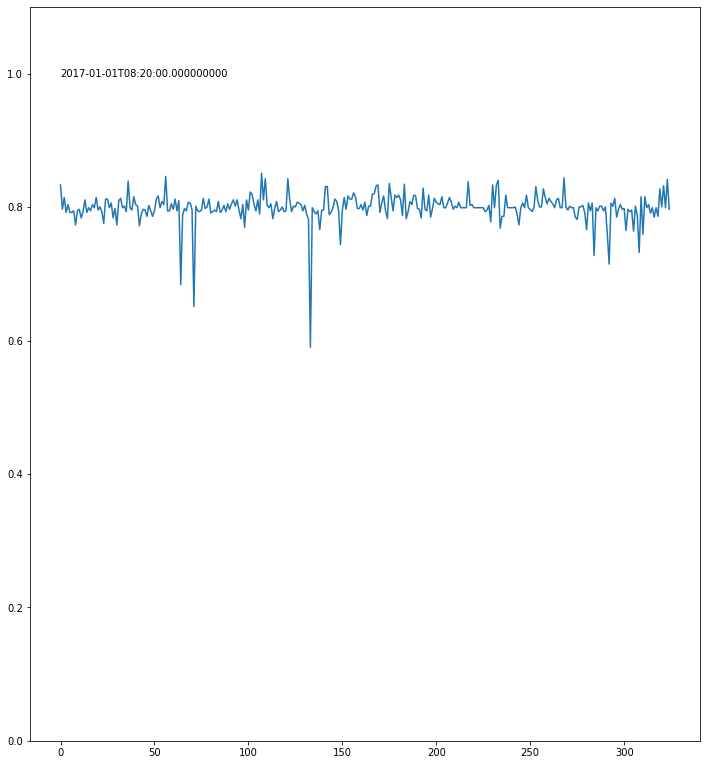

In [40]:
velocities = (speed_data.values - speed_data.values.min()) / (speed_data.values.max() - speed_data.values.min())
timestamps = speed_data.index.values

fig, ax = plt.subplots(figsize=(1.2*10, aspect_ratio*10))

ani = animation.FuncAnimation(fig, plot, frames=zip(velocities, timestamps), interval=200, fargs=(ax,))

HTML(ani.to_jshtml())

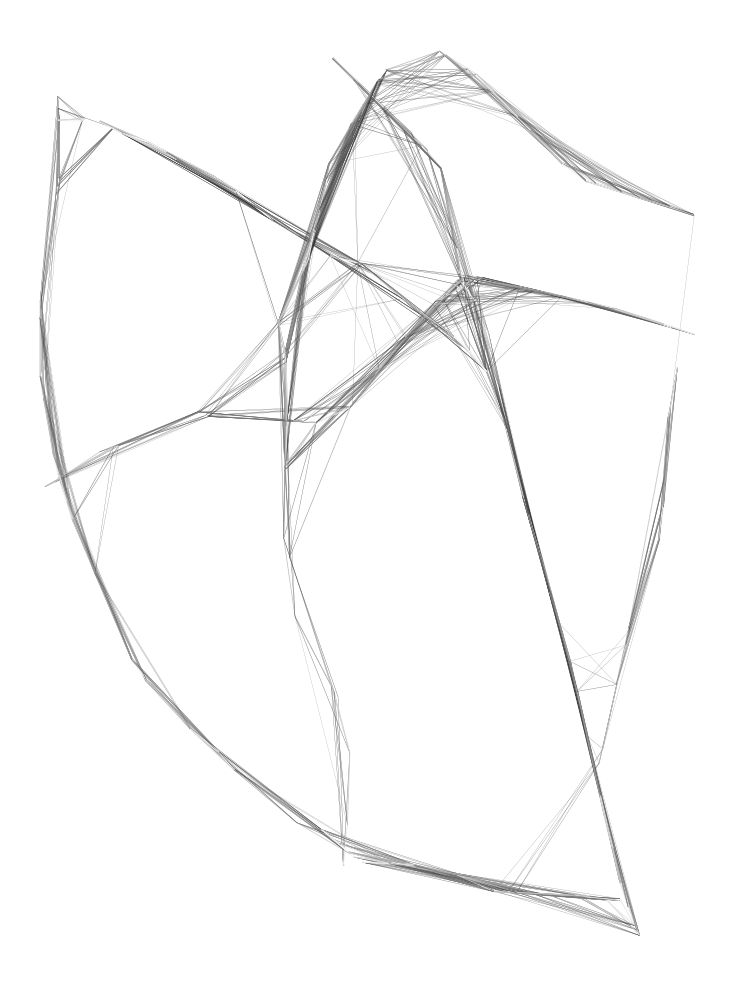

In [16]:
plt.figure(figsize=(10, aspect_ratio*10))

nx.draw(
    network,
    pos=locations[['x', 'y']].values,
    node_size=0,
    node_color='black',
    width=[network[u][v]['weight'] for u,v in network.edges()],
    edge_color=[[network[u][v]['weight']] * 3 for u,v in network.edges()]
)

In [41]:
def plot(velocity_timestamp, ax, network, locations):
    velocity, timestamp = velocity_timestamp
    ax.clear()
    ax.text(
        x=locations['x'].min(),
        y=locations['y'].max(),
        s=str(timestamp),
        horizontalalignment='center',
        verticalalignment='center'
    )
    nx.draw(
        network,
        pos=locations[['x', 'y']].values,
        node_size=100,
        node_color=velocity,
        width=[network[u][v]['weight'] for u,v in network.edges()],
        edge_color=[[network[u][v]['weight']] * 3 for u,v in network.edges()],
        cmap=plt.cm.coolwarm_r,
        vmin=0,
        vmax=1,
    )

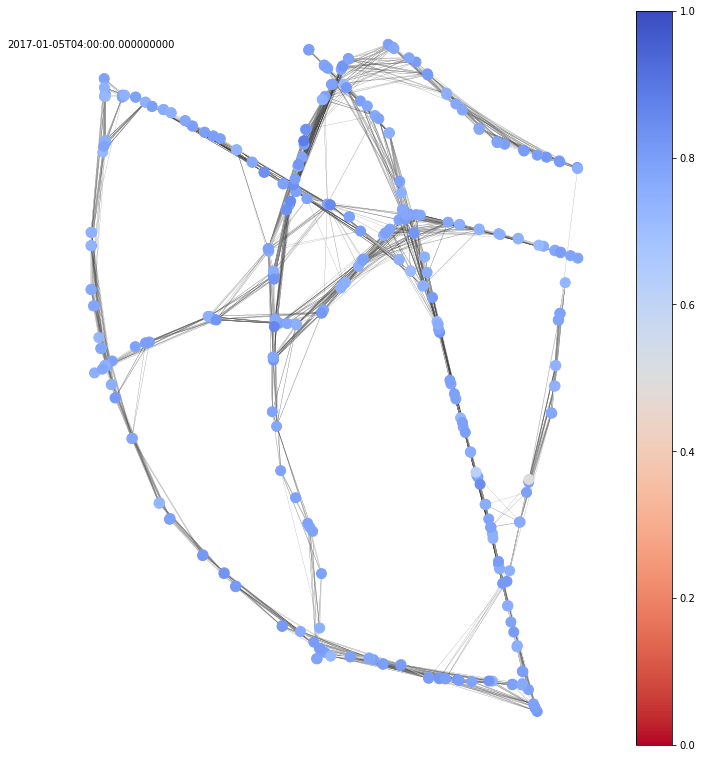

In [42]:
velocities = (speed_data.values - speed_data.values.min()) / (speed_data.values.max() - speed_data.values.min())
velocities = velocities[:30*24*12:12]
timestamps = speed_data.index.values[:30*24*12:12]

fig, ax = plt.subplots(figsize=(1.2*10, aspect_ratio*10))
sm = plt.cm.ScalarMappable(cmap=plt.cm.coolwarm_r, norm=plt.Normalize(vmin=0, vmax=1))
sm.set_array([])
fig.colorbar(sm, ax=ax)

ani = animation.FuncAnimation(fig, plot, frames=zip(velocities, timestamps), interval=200, fargs=(ax, network, locations))

HTML(ani.to_jshtml())

# Evaluation

As evaluation metric, we'll use MAE, MSE and Max diff.

For model evaluation we produce temporal split to train/test and evaluation datasets. We'll perform evaluation using 90%, 50% and 10% evaluation datasets. Datasets will have following configurations:

**Observation Windows (OW):** 1, 10, 100 timestamps

**Prediction Horizons (PH):** 1, 10, 100 timestamps

**Prediction Windows (PW):** 1, 10, 100 timestamps

Thus, for each model type we'll produce 81 different models for each dataset and evaluate them:

|         **Model**        |  **Dataset** | **Eval** |  **OW** |  **PH** |  **PW** | MAE | MSE | Max diff | 
|             :-           |      :-      |    :-    |    -:   |    -:   |    -:   | :-: | :-: |   :-:    |
| **MAE-optimal constant** | **PeMS-BAY** | **90%**  |  **1**  |  **1**  |  **1**  | ... | ... |    ...   |
|          **...**         |    **...**   | **...**  | **...** | **...** | **...** | ... | ... |    ...   |

In [36]:
LOSSES = {
    'MAE': {
        'loss': lambda y, y_pred: np.mean(np.abs(y - y_pred)),
        'torch': lambda y, y_pred: torch.mean(torch.abs(y - y_pred)),
    },
    'MSE': {
        'loss': lambda y, y_pred: np.mean(np.square(y - y_pred)),
        'torch': lambda y, y_pred: torch.mean(torch.square(y - y_pred)),
    },
    'Max diff': {
        'loss': lambda y, y_pred: np.max(np.abs(y - y_pred)),
        'torch': lambda y, y_pred: torch.max(torch.abs(y - y_pred)),
    },
}

# Dataset preparation

Evaluation dataset ratio $\alpha$ must be corrected, according to:

$$\frac{\alpha_\mathrm{corr} \cdot N - \left(\mathrm{OW} + \mathrm{PH} + \mathrm{OH} - 1\right)}{\left(1 - \alpha_\mathrm{corr}\right) \cdot N - \left(\mathrm{OW} + \mathrm{PH} + \mathrm{OH} - 1\right)} = \frac{\alpha}{1 - \alpha}$$

$$\alpha_\mathrm{corr} = \alpha + \frac{1 - 2 \alpha}{N} \cdot \left(\mathrm{OW} + \mathrm{PH} + \mathrm{OH} - 1\right)$$

# Tensors

As $X$ datasets we have tensors:

$\mathbf{V_O}$ - observation velocities tensor with shape $\mathrm{dim}\mathbf{V_O} = \left(N_\mathrm{observations};\mathrm{OW};N_\mathrm{sensors}\right)$

$\mathbf{T_O}$ - observation timestamps tensor with shape $\mathrm{dim}\mathbf{T_O} = \left(N_\mathrm{observations};\mathrm{OW}\right)$

$\mathbf{T_P}$ - prediction timestamps tensor with shape $\mathrm{dim}\mathbf{T_P} = \left(N_\mathrm{observations};\mathrm{PW}\right)$

$\mathbf{A}$ - adjacency matrix with shape $\mathrm{dim}\mathbf{A} = \left(N_\mathrm{sensors};N_\mathrm{sensors}\right)$

$\mathbf{D}$ - distances matrix with shape $\mathrm{dim}\mathbf{A} = \left(N_\mathrm{sensors};N_\mathrm{sensors}\right)$

As $Y$ we have tensor:

$\mathbf{V_P}$ - prediction velocities tensor with shape $\mathrm{dim}\mathbf{V_P} = \left(N_\mathrm{observations};\mathrm{PW};N_\mathrm{sensors}\right)$

In [19]:
T_O, V_O, T_P, V_P, A = tensor_split(speed_data, adjacency_matrix, distances, 10, 10, 10)

# Models

1. MAE, MSE and max diff-optimal constants
1. Linear regression on sensor data
1. FCN on sensor data
1. CNN on sensor data

Not (yet) considered:
1. Boosting on temporal and sensor data
1. RNN (LSTM) on sensor and temporal data for each sensor
1. RNN (LSTM) on temporal and spatial (graph node embeddings) data
1. GCN + LSTM

## 1. Optimal constants

In [20]:
class Constant(nn.Module):
    def __init__(self, init_value):
        super().__init__()
        self.constant = nn.Parameter(init_value.deep())
        nn.init.normal_(self.constant)
        
    def forward(self, _):
        return self.constant

In [15]:
n_epochs = 200

for eval_size, OW, PH, PW in itertools.product(
    [0.9, 0.5, 0.1],
    [1], # irrelevant
    [-1], # irrelevant
    [1, 10, 100],
):
    _, Y_train, _, Y_eval = prepare(speed_data, eval_size, OW, PH, PW)    
    Y_eval = torch.Tensor(Y_eval.values)
    Y_train = torch.Tensor(Y_train.values)
    
    for batch_size in [128, 512, 1024]:
        train_loader = DataLoader(dataset=TensorDataset(Y_train), batch_size=batch_size, shuffle=True)
                                  
        for target_loss in LOSSES:
            experiment = Experiment(
                api_key=COMET_ML_API_KEY,
                project_name=COMET_ML_PROJECT_NAME,
                workspace=COMET_ML_WORKSPACE,
            )
            experiment.log_parameters({
                'eval_size': eval_size,
                'OW': OW,
                'PH': PH,
                'PW': PW,
                'batch_size': batch_size,
                'model': f'{target_loss}-optimal constant',
                'dataset': 'PeMS-BAY',
            })

            model = Constant(Y_train.mean(dim=0))
            optimizer = torch.optim.Adam(model.parameters(), lr=1)

            losses = []
            eval_losses = []
            for epoch in tnrange(n_epochs):
                with experiment.test():
                    model.eval()
                    with torch.no_grad():
                        experiment.log_metric(
                            'train_MAE', LOSSES['MAE']['torch'](Y_train, model(None)).item(), epoch=epoch)
                        experiment.log_metric(
                            'train_MSE', LOSSES['MSE']['torch'](Y_train, model(None)).item(), epoch=epoch)
                        experiment.log_metric(
                            'train_Max_diff', LOSSES['Max diff']['torch'](Y_train, model(None)).item(), epoch=epoch)
                        experiment.log_metric(
                            'eval_MAE', LOSSES['MAE']['torch'](Y_eval, model(None)).item(), epoch=epoch)
                        experiment.log_metric(
                            'eval_MSE', LOSSES['MSE']['torch'](Y_eval, model(None)).item(), epoch=epoch)
                        experiment.log_metric(
                            'eval_Max_diff', LOSSES['Max diff']['torch'](Y_eval, model(None)).item(), epoch=epoch)
                with experiment.train():
                    model.train()
                    for (y,) in train_loader:
                        optimizer.zero_grad()
                        loss = LOSSES[target_loss]['torch'](y, model(None))
                        losses.append(loss.item())
                        loss.backward()
                        optimizer.step()
            with experiment.test():
                model.eval()
                with torch.no_grad():
                    experiment.log_metric(
                        'train_MAE', LOSSES['MAE']['torch'](Y_train, model(None)).item(), epoch=epoch)
                    experiment.log_metric(
                        'train_MSE', LOSSES['MSE']['torch'](Y_train, model(None)).item(), epoch=epoch)
                    experiment.log_metric(
                        'train_Max_diff', LOSSES['Max diff']['torch'](Y_train, model(None)).item(), epoch=epoch)
                    experiment.log_metric(
                        'eval_MAE', LOSSES['MAE']['torch'](Y_eval, model(None)).item(), epoch=epoch)
                    experiment.log_metric(
                        'eval_MSE', LOSSES['MSE']['torch'](Y_eval, model(None)).item(), epoch=epoch)
                    experiment.log_metric(
                        'eval_Max_diff', LOSSES['Max diff']['torch'](Y_eval, model(None)).item(), epoch=epoch)
            experiment.end()
    gc.collect()

KeyboardInterrupt: 

## 2. Linear regression on sensor data

In [21]:
class LinReg(nn.Module):
    def __init__(self, N_sensors, OW, PW):
        super().__init__()
        self.N_sensors = N_sensors
        self.OW = OW
        self.PW = PW
        self.linear = nn.Linear(N_sensors*OW, N_sensors*PW)
    def forward(self, x):
        return self.linear(x.flatten(start_dim=1)).reshape(-1, PW, N_sensors)

In [22]:
OW, PH, PW = 10, 10, 10
eval_size = 0.9

train_dataset, eval_dataset = prepare_tensors(speed_data, adjacency_matrix, distances, eval_size, OW, PH, PW)

In [23]:
T_O_train, V_O_train, T_P_train, V_P_train, A = train_dataset

In [24]:
N_sensors = V_O_train.shape[-1]

In [25]:
T_O_eval, V_O_eval, T_P_eval, V_P_eval, _ = eval_dataset

In [28]:
n_epochs = 100
batch_size = 1024

train_loader = DataLoader(dataset=TensorDataset(V_O_train, V_P_train), batch_size=batch_size, shuffle=True)

for target_loss in LOSSES:
    experiment = Experiment(
        api_key=COMET_ML_API_KEY,
        project_name=COMET_ML_PROJECT_NAME,
        workspace=COMET_ML_WORKSPACE,
    )
    experiment.log_parameters({
        'eval_size': eval_size,
        'OW': OW,
        'PH': PH,
        'PW': PW,
        'batch_size': batch_size,
        'model': f'{target_loss}-optimal linear regression',
        'dataset': 'PeMS-BAY',
    })

    model = LinReg(N_sensors, OW, PW)
    optimizer = torch.optim.Adam(model.parameters(), lr=0.01)

    losses = []
    eval_losses = []
    for epoch in tnrange(n_epochs):
        with experiment.test():
            model.eval()
            with torch.no_grad():
                experiment.log_metric(
                    'train_MAE', LOSSES['MAE']['torch'](V_P_train, model(V_O_train)).item(), epoch=epoch)
                experiment.log_metric(
                    'train_MSE', LOSSES['MSE']['torch'](V_P_train, model(V_O_train)).item(), epoch=epoch)
                experiment.log_metric(
                    'train_Max_diff', LOSSES['Max diff']['torch'](V_P_train, model(V_O_train)).item(), epoch=epoch)
                experiment.log_metric(
                    'eval_MAE', LOSSES['MAE']['torch'](V_P_eval, model(V_P_eval)).item(), epoch=epoch)
                experiment.log_metric(
                    'eval_MSE', LOSSES['MSE']['torch'](V_P_eval, model(V_P_eval)).item(), epoch=epoch)
                experiment.log_metric(
                    'eval_Max_diff', LOSSES['Max diff']['torch'](V_P_eval, model(V_P_eval)).item(), epoch=epoch)
        with experiment.train():
            model.train()
            for (x, y) in train_loader:
                optimizer.zero_grad()
                loss = LOSSES[target_loss]['torch'](y, model(x))
                losses.append(loss.item())
                loss.backward()
                optimizer.step()
    with experiment.test():
        model.eval()
        with torch.no_grad():
            experiment.log_metric(
                'train_MAE', LOSSES['MAE']['torch'](V_P_train, model(V_O_train)).item(), epoch=epoch)
            experiment.log_metric(
                'train_MSE', LOSSES['MSE']['torch'](V_P_train, model(V_O_train)).item(), epoch=epoch)
            experiment.log_metric(
                'train_Max_diff', LOSSES['Max diff']['torch'](V_P_train, model(V_O_train)).item(), epoch=epoch)
            experiment.log_metric(
                'eval_MAE', LOSSES['MAE']['torch'](V_P_eval, model(V_P_eval)).item(), epoch=epoch)
            experiment.log_metric(
                'eval_MSE', LOSSES['MSE']['torch'](V_P_eval, model(V_P_eval)).item(), epoch=epoch)
            experiment.log_metric(
                'eval_Max_diff', LOSSES['Max diff']['torch'](V_P_eval, model(V_P_eval)).item(), epoch=epoch)
    experiment.end()
gc.collect()

COMET INFO: Experiment is live on comet.ml https://www.comet.ml/nikolai-semenov/traffic-modeling/14295a56238a4cf78bd45b3a26d97d99



COMET INFO: ---------------------------
COMET INFO: Comet.ml Experiment Summary
COMET INFO: ---------------------------
COMET INFO:   Data:
COMET INFO:     display_summary_level : 1
COMET INFO:     url                   : https://www.comet.ml/nikolai-semenov/traffic-modeling/14295a56238a4cf78bd45b3a26d97d99
COMET INFO:   Metrics [count] (min, max):
COMET INFO:     test_eval_MAE [101]       : (63.874114990234375, 486.76318359375)
COMET INFO:     test_eval_MSE [101]       : (5292.58154296875, 288630.34375)
COMET INFO:     test_eval_Max_diff [101]  : (224.86509704589844, 2252.212890625)
COMET INFO:     test_train_MAE [101]      : (63.76252746582031, 485.9306335449219)
COMET INFO:     test_train_MSE [101]      : (5262.21630859375, 287651.625)
COMET INFO:     test_train_Max_diff [101] : (219.33485412597656, 2279.859130859375)
COMET INFO:     train_loss [60]           : (63.7342414855957, 506.891357421875)
COMET INFO:   Parameters:
COMET INFO:     OW         : 10
COMET INFO:     PH         :

COMET INFO: ---------------------------
COMET INFO: Comet.ml Experiment Summary
COMET INFO: ---------------------------
COMET INFO:   Data:
COMET INFO:     display_summary_level : 1
COMET INFO:     url                   : https://www.comet.ml/nikolai-semenov/traffic-modeling/0279af4dc2724a29813459b68891097a
COMET INFO:   Metrics [count] (min, max):
COMET INFO:     test_eval_MAE [101]       : (4.097946643829346, 657.6129760742188)
COMET INFO:     test_eval_MSE [101]       : (45.10438919067383, 437521.71875)
COMET INFO:     test_eval_Max_diff [101]  : (92.68123626708984, 924.858154296875)
COMET INFO:     test_train_MAE [101]      : (3.0928144454956055, 656.4540405273438)
COMET INFO:     test_train_MSE [101]      : (26.776700973510742, 436034.75)
COMET INFO:     test_train_Max_diff [101] : (58.6113166809082, 922.1806030273438)
COMET INFO:     train_loss [60]           : (26.355518341064453, 1013092.5625)
COMET INFO:   Parameters:
COMET INFO:     OW         : 10
COMET INFO:     PH         

COMET INFO: ---------------------------
COMET INFO: Comet.ml Experiment Summary
COMET INFO: ---------------------------
COMET INFO:   Data:
COMET INFO:     display_summary_level : 1
COMET INFO:     url                   : https://www.comet.ml/nikolai-semenov/traffic-modeling/6e73493d17264116b66c1f3888cfff2c
COMET INFO:   Metrics [count] (min, max):
COMET INFO:     test_eval_MAE [101]       : (63.3604850769043, 64.48185729980469)
COMET INFO:     test_eval_MSE [101]       : (5219.04541015625, 10316.64453125)
COMET INFO:     test_eval_Max_diff [101]  : (200.120849609375, 4416.951171875)
COMET INFO:     test_train_MAE [101]      : (63.23535919189453, 64.35098266601562)
COMET INFO:     test_train_MSE [101]      : (5190.26806640625, 10270.7392578125)
COMET INFO:     test_train_Max_diff [101] : (191.09893798828125, 4476.07568359375)
COMET INFO:     train_loss [60]           : (213.7698974609375, 3000.3876953125)
COMET INFO:   Parameters:
COMET INFO:     OW         : 10
COMET INFO:     PH     

214

## 3. FCN on sensor data

In [26]:
class FCN(nn.Module):
    def __init__(self, N_sensors, OW, PW, N1, N2):
        super().__init__()
        self.N_sensors = N_sensors
        self.OW = OW
        self.PW = PW
        self.linear1 = nn.Linear(N_sensors*OW, N1*N_sensors*OW)
        self.a1 = nn.ReLU()
        self.linear2 = nn.Linear(N1*N_sensors*OW, N2*N_sensors*PW)
        self.a2 = nn.ReLU()
        self.linear3 = nn.Linear(N2*N_sensors*PW, N_sensors*PW)
        
    def forward(self, x):
        x = x.flatten(start_dim=1)
        x = self.linear1(x)
        x = self.a1(x)
        x = self.linear2(x)
        x = self.a2(x)
        return self.linear3(x).reshape(-1, PW, N_sensors)

In [ ]:
n_epochs = 100
batch_size = 128

train_loader = DataLoader(dataset=TensorDataset(V_O_train, V_P_train), batch_size=batch_size, shuffle=True)
eval_loader = DataLoader(dataset=TensorDataset(V_O_eval, V_P_eval), batch_size=batch_size, shuffle=True)

for target_loss in LOSSES:
    experiment = Experiment(
        api_key=COMET_ML_API_KEY,
        project_name=COMET_ML_PROJECT_NAME,
        workspace=COMET_ML_WORKSPACE,
    )
    experiment.log_parameters({
        'eval_size': eval_size,
        'OW': OW,
        'PH': PH,
        'PW': PW,
        'batch_size': batch_size,
        'model': f'{target_loss}-optimal FCN',
        'dataset': 'PeMS-BAY',
    })

    model = FCN(N_sensors, OW, PW, 10, 10)
    optimizer = torch.optim.Adam(model.parameters(), lr=0.01)

    losses = []
    eval_losses = []
    for epoch in tnrange(n_epochs):
        with experiment.test():
            model.eval()
            with torch.no_grad():
                for (x, y) in train_loader:
                    experiment.log_metric(
                    'train_MAE', LOSSES['MAE']['torch'](y, model(x)).item(), epoch=epoch)
                    experiment.log_metric(
                        'train_MSE', LOSSES['MSE']['torch'](y, model(x)).item(), epoch=epoch)
                    experiment.log_metric(
                        'train_Max_diff', LOSSES['Max diff']['torch'](y, model(x)).item(), epoch=epoch)
                    break
                for (x, y) in eval_loader:
                    experiment.log_metric(
                        'eval_MAE', LOSSES['MAE']['torch'](y, model(x)).item(), epoch=epoch)
                    experiment.log_metric(
                        'eval_MSE', LOSSES['MSE']['torch'](y, model(x)).item(), epoch=epoch)
                    experiment.log_metric(
                        'eval_Max_diff', LOSSES['Max diff']['torch'](y, model(x)).item(), epoch=epoch)
                    break
        with experiment.train():
            model.train()
            for (x, y) in train_loader:
                optimizer.zero_grad()
                loss = LOSSES[target_loss]['torch'](y, model(x))
                losses.append(loss.item())
                loss.backward()
                optimizer.step()
    with experiment.test():
        model.eval()
        with torch.no_grad():
            for (x, y) in train_loader:
                experiment.log_metric(
                'train_MAE', LOSSES['MAE']['torch'](y, model(x)).item(), epoch=epoch)
                experiment.log_metric(
                    'train_MSE', LOSSES['MSE']['torch'](y, model(x)).item(), epoch=epoch)
                experiment.log_metric(
                    'train_Max_diff', LOSSES['Max diff']['torch'](y, model(x)).item(), epoch=epoch)
                break
            for (x, y) in eval_loader:
                experiment.log_metric(
                    'eval_MAE', LOSSES['MAE']['torch'](y, model(x)).item(), epoch=epoch)
                experiment.log_metric(
                    'eval_MSE', LOSSES['MSE']['torch'](y, model(x)).item(), epoch=epoch)
                experiment.log_metric(
                    'eval_Max_diff', LOSSES['Max diff']['torch'](y, model(x)).item(), epoch=epoch)
                break
    experiment.end()
gc.collect()

COMET INFO: Experiment is live on comet.ml https://www.comet.ml/nikolai-semenov/traffic-modeling/2d63c8e4e0354eed8c8cd0982f4ab069



## 4. CNN on sensor data

In [34]:
class CNN(nn.Module):
    def __init__(self, N_sensors, OW, PW, N1, N2):
        super().__init__()
        self.N_sensors = N_sensors
        self.OW = OW
        self.PW = PW
        self.c1 = nn.Conv1d(N_sensors, N1*N_sensors, (3,))
        self.a1 = nn.ReLU()
        self.c2 = nn.Conv1d(N1*N_sensors, N2*N_sensors, (3,))
        self.a2 = nn.ReLU()
        self.linear1 = nn.Linear(N2*N_sensors, N_sensors*PW)
        
    def forward(self, x):
        x = x.permute(0, 2, 1)
        x = self.c1(x)
        x = self.a1(x)
        x = self.c2(x)
        x = self.a2(x)
        x = x.mean(-1)
        return self.linear1(x).reshape(-1, PW, N_sensors)

In [37]:
n_epochs = 100
batch_size = 128

train_loader = DataLoader(dataset=TensorDataset(V_O_train, V_P_train), batch_size=batch_size, shuffle=True)
eval_loader = DataLoader(dataset=TensorDataset(V_O_eval, V_P_eval), batch_size=batch_size, shuffle=True)

target_loss = 'MAE'

experiment = Experiment(
    api_key=COMET_ML_API_KEY,
    project_name=COMET_ML_PROJECT_NAME,
    workspace=COMET_ML_WORKSPACE,
)
experiment.log_parameters({
    'eval_size': eval_size,
    'OW': OW,
    'PH': PH,
    'PW': PW,
    'batch_size': batch_size,
    'model': f'{target_loss}-optimal CNN',
    'dataset': 'PeMS-BAY',
})

model = CNN(N_sensors, OW, PW, 10, 10)
optimizer = torch.optim.Adam(model.parameters(), lr=0.01)

losses = []
eval_losses = []
for epoch in tnrange(n_epochs):
    with experiment.test():
        model.eval()
        with torch.no_grad():
            for (x, y) in train_loader:
                experiment.log_metric(
                'train_MAE', LOSSES['MAE']['torch'](y, model(x)).item(), epoch=epoch)
                experiment.log_metric(
                    'train_MSE', LOSSES['MSE']['torch'](y, model(x)).item(), epoch=epoch)
                experiment.log_metric(
                    'train_Max_diff', LOSSES['Max diff']['torch'](y, model(x)).item(), epoch=epoch)
                break
            for (x, y) in eval_loader:
                experiment.log_metric(
                    'eval_MAE', LOSSES['MAE']['torch'](y, model(x)).item(), epoch=epoch)
                experiment.log_metric(
                    'eval_MSE', LOSSES['MSE']['torch'](y, model(x)).item(), epoch=epoch)
                experiment.log_metric(
                    'eval_Max_diff', LOSSES['Max diff']['torch'](y, model(x)).item(), epoch=epoch)
                break
    with experiment.train():
        model.train()
        for (x, y) in train_loader:
            optimizer.zero_grad()
            loss = LOSSES[target_loss]['torch'](y, model(x))
            losses.append(loss.item())
            loss.backward()
            optimizer.step()
with experiment.test():
    model.eval()
    with torch.no_grad():
        for (x, y) in train_loader:
            experiment.log_metric(
            'train_MAE', LOSSES['MAE']['torch'](y, model(x)).item(), epoch=epoch)
            experiment.log_metric(
                'train_MSE', LOSSES['MSE']['torch'](y, model(x)).item(), epoch=epoch)
            experiment.log_metric(
                'train_Max_diff', LOSSES['Max diff']['torch'](y, model(x)).item(), epoch=epoch)
            break
        for (x, y) in eval_loader:
            experiment.log_metric(
                'eval_MAE', LOSSES['MAE']['torch'](y, model(x)).item(), epoch=epoch)
            experiment.log_metric(
                'eval_MSE', LOSSES['MSE']['torch'](y, model(x)).item(), epoch=epoch)
            experiment.log_metric(
                'eval_Max_diff', LOSSES['Max diff']['torch'](y, model(x)).item(), epoch=epoch)
            break
experiment.end()
gc.collect()

COMET INFO: ---------------------------
COMET INFO: Comet.ml Experiment Summary
COMET INFO: ---------------------------
COMET INFO:   Data:
COMET INFO:     display_summary_level : 1
COMET INFO:     url                   : https://www.comet.ml/nikolai-semenov/traffic-modeling/574d02ac43de4346b006c553b6836ef1
COMET INFO:   Parameters:
COMET INFO:     OW         : 10
COMET INFO:     PH         : 10
COMET INFO:     PW         : 10
COMET INFO:     batch_size : 128
COMET INFO:     dataset    : PeMS-BAY
COMET INFO:     eval_size  : 0.9
COMET INFO:     model      : MAE-optimal CNN
COMET INFO:   Uploads:
COMET INFO:     environment details      : 1
COMET INFO:     filename                 : 1
COMET INFO:     git metadata             : 1
COMET INFO:     git-patch (uncompressed) : 1 (33 KB)
COMET INFO:     installed packages       : 1
COMET INFO:     os packages              : 1
COMET INFO: ---------------------------
COMET INFO: Experiment is live on comet.ml https://www.comet.ml/nikolai-semenov

KeyboardInterrupt: 